# Week 4

Yay! It's week 4. Last week had a lot of material, this week we only have three components with very little reading. 


## Overview

* A video lecture with a few questions
* An exercise on visualizing geodata using a different set of tools from the ones we played with previously.
* Thinking about visualization, data quality, and binning. Why ***looking at the details of the data before applying fancy methods*** is often important.

## Part 1: More lecturing on dataviz

We begin today by learning more about the theory of visualization, digging into data encodings and representations.

[![IMAGE ALT TEXT HERE](https://img.youtube.com/vi/zE6Nr8trdrw/0.jpg)](https://www.youtube.com/watch?v=zE6Nr8trdrw)

> *Excercise:* Some questions about the video. <font color=gray>Try to answer using your human brain (rather than your LLMs first). </font>
>
> * Mention 10 examples of ways we can encode data.
> * Are all encodings created equally? Why not? Can you think of an example from the previous lectures?
> * Mention 3 encodings that are difficult for the human eye to parse. Can you find an example of a visualization online that uses one of those three?
> * Explain in your own words: What is the problem with pie-charts?

## Part 2: Visualizing geo-data

It turns out that `plotly` (which we used during Week 2) is not the only way of working with geo-data. There are many different ways to go about it. (The more advanced PhD and PostDoc researchers in my group simply use matplotlib, since that provides more control. For an example of that kind of thing, check out [this tutorial](https://towardsdatascience.com/visualizing-geospatial-data-in-python-e070374fe621).)

Today, we'll try another library for geodata called [Folium](https://github.com/python-visualization/folium). It's good for you all to try out a few different libraries - remember that data visualization and analysis in Python is all about the ability to use many different tools. 

The exercise below is based on the code illustrated in this nice [tutorial](https://www.kaggle.com/daveianhickey/how-to-folium-for-maps-heatmaps-time-data), so let us start by taking a look at that one.

*Reading*. Read through the following tutorial
 * "How to: Folium for maps, heatmaps & time data". Get it here: https://www.kaggle.com/daveianhickey/how-to-folium-for-maps-heatmaps-time-data. \[**UPDATE 2024**: Note that the Stamen tiles are no longer avialible.\]
 * (Optional) There are also some nice tricks in "Spatial Visualizations and Analysis in Python with Folium". Read it here: https://towardsdatascience.com/data-101s-spatial-visualizations-and-analysis-in-python-with-folium-39730da2adf

> *Exercise*: A different take on geospatial data. <font color=gray>It's OK to use your LLM for all of the Folium exercises</font>.
>
>A couple of weeks ago (Part 3 of Week 2), we worked with spacial data by using color-intensity of shapefiles to show the counts of certain crimes within those individual areas. Today, we look at studying geospatial data by plotting raw data points as well as heatmaps on top of actual maps.
> 
> * First start by plotting a map of San Francisco with a nice tight zoom. Simply use the command `folium.Map([lat, lon], zoom_start=13)`, where you'll have to look up San Francisco's longitude and latitude.
> * Next, use the the coordinates for SF City Hall `37.77919, -122.41914` to indicate its location on the map with a nice, pop-up enabled maker. (In the screenshot below, I used the black & white Stamen tiles, because they look cool. <mark>**UPDATE 2024**: Note that the Stamen tiles are no longer avialible, but there are many other tile-options. Link for more options on Stamen [**here**](https://stamen.com/here-comes-the-future-of-stamen-maps/)</mark>).
>  
> <img src="https://raw.githubusercontent.com/suneman/socialdata2022/main/files/city_hall_2022.png" alt="drawing" width="600"/>
>
> * Now, let's plot some more data (no need for pop-ups this time). Select a couple of months of data for `'DRUG/NARCOTIC'` and draw a little dot for each arrest for those two months. You could, for example, choose June-July 2016, but you can choose anything you like - the main concern is to not have too many points as this uses a lot of memory and makes Folium behave non-optimally. 
> We can call this kind of visualization a *point scatter plot*.

Ok. Time for a little break. Note that a nice thing about Folium is that you can zoom in and out of the maps.

> *Exercise*: Heatmaps.
> * Now, let's play with **heatmaps**. You can figure out the appropriate commands by grabbing code from the main [tutorial](https://www.kaggle.com/daveianhickey/how-to-folium-for-maps-heatmaps-time-data)) and modifying to suit your needs.
>    * To create your first heatmap, grab all arrests for the category `'SEX OFFENSES, NON FORCIBLE'` across all time. Play with parameters to get plots you like.
>    * Now, comment on the differences between scatter plots and heatmaps. 
>.      - What can you see using the scatter-plots that you can't see using the heatmaps? 
>.      - And *vice versa*: what does the heatmaps help you see that's difficult to distinguish in the scatter-plots?
>    * Play around with the various parameters for heatmaps. You can find a list here: https://python-visualization.github.io/folium/plugins.html
>    * Comment on the effect on the various parameters for the heatmaps. How do they change the picture? (at least talk about the `radius` and `blur`).

In [132]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import folium

police_2018 = pd.read_csv("Police_Reports_2018.csv")
pd.options.mode.chained_assignment = None  # default='warn'

In [14]:
police_2018.columns

Index(['PdId', 'IncidntNum', 'Incident Code', 'Category', 'Descript',
       'DayOfWeek', 'Date', 'Time', 'PdDistrict', 'Resolution', 'Address', 'X',
       'Y', 'location', 'SF Find Neighborhoods 2 2',
       'Current Police Districts 2 2', 'Current Supervisor Districts 2 2',
       'Analysis Neighborhoods 2 2', 'DELETE - Fire Prevention Districts 2 2',
       'DELETE - Police Districts 2 2', 'DELETE - Supervisor Districts 2 2',
       'DELETE - Zip Codes 2 2', 'DELETE - Neighborhoods 2 2',
       'DELETE - 2017 Fix It Zones 2 2',
       'Civic Center Harm Reduction Project Boundary 2 2',
       'Fix It Zones as of 2017-11-06  2 2', 'DELETE - HSOC Zones 2 2',
       'Fix It Zones as of 2018-02-07 2 2',
       'CBD, BID and GBD Boundaries as of 2017 2 2',
       'Areas of Vulnerability, 2016 2 2',
       'Central Market/Tenderloin Boundary 2 2',
       'Central Market/Tenderloin Boundary Polygon - Updated 2 2',
       'HSOC Zones as of 2018-06-05 2 2', 'OWED Public Spaces 2 2',
       

In [21]:
police_2018[police_2018["Incident Code"]==3074]

,PdId,IncidntNum,Incident Code,Category,Descript,DayOfWeek,Date,Time,PdDistrict,Resolution,...,Fix It Zones as of 2017-11-06 2 2,DELETE - HSOC Zones 2 2,Fix It Zones as of 2018-02-07 2 2,"CBD, BID and GBD Boundaries as of 2017 2 2","Areas of Vulnerability, 2016 2 2",Central Market/Tenderloin Boundary 2 2,Central Market/Tenderloin Boundary Polygon - Updated 2 2,HSOC Zones as of 2018-06-05 2 2,OWED Public Spaces 2 2,Neighborhoods 2
0,4133422003074,41334220,3074,ROBBERY,"ROBBERY, BODILY FORCE",Monday,11/22/2004,17:50,INGLESIDE,NONE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
77,3122407303074,31224073,3074,ROBBERY,"ROBBERY, BODILY FORCE",Friday,10/17/2003,19:56,RICHMOND,"ARREST, BOOKED",...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,5.0
560,10110650303074,101106503,3074,ROBBERY,"ROBBERY, BODILY FORCE",Tuesday,11/30/2010,12:45,RICHMOND,"ARREST, BOOKED",...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,12.0
997,8081415003074,80814150,3074,ROBBERY,"ROBBERY, BODILY FORCE",Saturday,08/02/2008,19:28,NORTHERN,"ARREST, BOOKED",...,NaN,NaN,NaN,NaN,2.0,1.0,1.0,NaN,NaN,20.0
1488,12042963903074,120429639,3074,ROBBERY,"ROBBERY, BODILY FORCE",Wednesday,05/30/2012,19:00,INGLESIDE,"ARREST, BOOKED",...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,83.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2128635,17065527603074,170655276,3074,ROBBERY,"ROBBERY, BODILY FORCE",Friday,08/11/2017,21:20,RICHMOND,NONE,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,9.0
2128820,17052861703074,170528617,3074,ROBBERY,"ROBBERY, BODILY FORCE",Wednesday,06/28/2017,22:40,MISSION,NONE,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,53.0
2129072,17069224003074,170692240,3074,ROBBERY,"ROBBERY, BODILY FORCE",Thursday,08/24/2017,11:00,MISSION,NONE,...,14.0,3.0,14.0,NaN,2.0,NaN,NaN,3.0,NaN,53.0
2129081,16099259903074,160992599,3074,ROBBERY,"ROBBERY, BODILY FORCE",Tuesday,12/06/2016,18:50,PARK,NONE,...,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,103.0


In [142]:
import pandas as pd

grouped = police_2018.groupby('Descript')['Incident Code'].nunique()
errors = grouped[grouped > 1]

if len(errors) == 0:
    print("There are no errors. Each description is linked to a unique incident code.")
else:
    print("Errors found:")
    print(errors)

Errors found:
Descript
BRIBERY OF WITNESSES                 2
FALSE IMPRISONMENT                   2
GRAND THEFT BY PROSTITUTE            4
GRAND THEFT FROM PERSON              4
GRAND THEFT PICKPOCKET               4
GRAND THEFT PURSESNATCH              4
HAZARDOUS MATERIALS, SPILL LOAD      2
PETTY THEFT AUTO STRIP               3
PETTY THEFT BICYCLE                  3
PETTY THEFT COIN OPERATED MACHINE    3
PETTY THEFT FROM A BUILDING          3
PETTY THEFT FROM LOCKED AUTO         3
PETTY THEFT FROM UNLOCKED AUTO       3
PETTY THEFT MOTORCYCLE STRIP         3
PETTY THEFT OF PROPERTY              3
PETTY THEFT PHONE BOOTH              3
PETTY THEFT SHOPLIFTING              3
ROBBERY,  ATM, FORCE, ATT.           2
THEFT, BOAT                          2
VIOLATION OF RESTRAINING ORDER       2
Name: Incident Code, dtype: int64


In [144]:
police_2018[police_2018["Descript"]=="GRAND THEFT FROM PERSON"]

,PdId,IncidntNum,Incident Code,Category,Descript,DayOfWeek,Date,Time,PdDistrict,Resolution,...,Fix It Zones as of 2017-11-06 2 2,DELETE - HSOC Zones 2 2,Fix It Zones as of 2018-02-07 2 2,"CBD, BID and GBD Boundaries as of 2017 2 2","Areas of Vulnerability, 2016 2 2",Central Market/Tenderloin Boundary 2 2,Central Market/Tenderloin Boundary Polygon - Updated 2 2,HSOC Zones as of 2018-06-05 2 2,OWED Public Spaces 2 2,Neighborhoods 2
27,3044800006154,30448000,6154,LARCENY/THEFT,GRAND THEFT FROM PERSON,Friday,01/24/2003,19:00,RICHMOND,NONE,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,8.0
92,10088872606151,100888726,6151,LARCENY/THEFT,GRAND THEFT FROM PERSON,Friday,09/24/2010,15:30,CENTRAL,NONE,...,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,107.0
354,12059082606153,120590826,6153,LARCENY/THEFT,GRAND THEFT FROM PERSON,Thursday,07/26/2012,17:20,NORTHERN,NONE,...,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,23.0
355,9098262806154,90982628,6154,LARCENY/THEFT,GRAND THEFT FROM PERSON,Tuesday,09/22/2009,17:10,NORTHERN,NONE,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,20.0
421,10099157306152,100991573,6152,LARCENY/THEFT,GRAND THEFT FROM PERSON,Monday,10/25/2010,10:45,SOUTHERN,NONE,...,NaN,NaN,NaN,4.0,2.0,NaN,NaN,NaN,NaN,32.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2129010,17077368006154,170773680,6154,LARCENY/THEFT,GRAND THEFT FROM PERSON,Friday,09/22/2017,07:37,BAYVIEW,NONE,...,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,86.0
2129060,17055639506153,170556395,6153,LARCENY/THEFT,GRAND THEFT FROM PERSON,Sunday,07/09/2017,09:15,BAYVIEW,NONE,...,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,86.0
2129088,17080837806152,170808378,6152,LARCENY/THEFT,GRAND THEFT FROM PERSON,Tuesday,10/03/2017,21:30,INGLESIDE,NONE,...,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,80.0
2129149,17033902206152,170339022,6152,LARCENY/THEFT,GRAND THEFT FROM PERSON,Tuesday,04/25/2017,03:31,MISSION,NONE,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,115.0


In [32]:
police_2018["Incident Code"].count

<bound method Series.count of 0           3074
1           7021
2           7021
3          26030
4           4134
           ...  
2129520    16710
2129521     4014
2129522    65010
2129523    30130
2129524    28160
Name: Incident Code, Length: 2129525, dtype: int64>

In [33]:
police_2018["Descript"].count

<bound method Series.count of 0                              ROBBERY, BODILY FORCE
1                                  STOLEN AUTOMOBILE
2                                  STOLEN AUTOMOBILE
3                                              ARSON
4                                            BATTERY
                             ...                    
2129520        POSSESSION OF NARCOTICS PARAPHERNALIA
2129521         AGGRAVATED ASSAULT WITH BODILY FORCE
2129522                     TRAFFIC VIOLATION ARREST
2129523                   PEDDLING WITHOUT A LICENSE
2129524    MALICIOUS MISCHIEF, VANDALISM OF VEHICLES
Name: Descript, Length: 2129525, dtype: object>

In [29]:
len(list(police_2018["Descript"].unique()))

847

In [2]:
map_SF = folium.Map([37.773972, -122.431297], zoom_start=13)

In [3]:
folium.Marker([37.77919,-122.41914], popup='Town hall').add_to(map_SF)
map_SF

In [4]:
Drugs_data = police_2018[police_2018['Category'] == 'DRUG/NARCOTIC']
Drugs_data['Date'] = pd.to_datetime(Drugs_data['Date'], format='%m/%d/%Y')

# Filter the DataFrame for the first three months of the year
drugs_df = Drugs_data[(Drugs_data['Date'].dt.year == 2010) & (Drugs_data['Date'].dt.month == 1)]


In [5]:
K = 10
for index in list(drugs_df.index)[:K]:
    #print(filtered_df.loc[index]["X"])
    folium.Marker([drugs_df.loc[index]["Y"],drugs_df.loc[index]["X"]], popup=drugs_df.loc[index]["Descript"]).add_to(map_SF)

In [6]:
#map_SF

In [7]:
from folium import plugins
from folium.plugins import HeatMap

sex_data = police_2018[police_2018['Category'] == 'SEX OFFENSES, NON FORCIBLE']
map_SF2 = folium.Map([37.773972, -122.431297], zoom_start=13)

# Ensure you're handing it floats
sex_data = police_2018[police_2018['Category'] == 'SEX OFFENSES, NON FORCIBLE']
sex_data['X'] = sex_data['X'].astype(float)
sex_data['Y'] = sex_data['Y'].astype(float)
sex_data = sex_data[['X', 'Y']]
sex_data = sex_data.dropna(axis=0, subset=['X','Y'])
sex_list = [[row['Y'],row['X']] for index, row in sex_data.iterrows()]
HeatMap(sex_list, radius=25, blur = 15).add_to(map_SF2)


In [8]:
map_SF2

#### Blur determines how "blurry" the marked locations are, which allows it to look as if the different markers are flowing together of sorts, when there are multiple around eachother. A high blur value, also makes the markers highly see-through.
#### Radius is simply the radius of the circle induced on a location.

For the final element of working with heatmaps, let's now use the cool Folium functionality `HeatMapWithTime` to create a visualization of how the patterns of your favorite crime-type changes over time.

> *Exercise*: Heatmap movies. This exercise is a bit more independent than above - you get to make all the choices.
> * Start by choosing your favorite crimetype. Prefereably one with spatial patterns that change over time (use your data-exploration from the previous lectures to choose a good one).
> * Now, choose a time-resolution. You could plot daily, weekly, monthly datasets to plot in your movie. Again the goal is to find interesting temporal patterns to display. We want at least 20 frames though.
> * Create the movie using `HeatMapWithTime`.
> * Comment on your results: 
>   - What patterns does your movie reveal?
>   - Motivate/explain the reasoning behind your choice of crimetype and time-resolution. 

In [9]:
# Assuming df is your DataFrame containing the data
sex_data = police_2018[police_2018['Category'] == 'ROBBERY']
sex_data['X'] = sex_data['X'].astype(float)
sex_data['Y'] = sex_data['Y'].astype(float)
# Convert the 'Date' column to datetime format
sex_data['Date'] = pd.to_datetime(sex_data['Date'], format='%m/%d/%Y')
# Initialize an empty list to store the results
heat_data = []

for year in range(2005, 2011):
    for quarter in range(1, 5):  # Quarters: 1 - Jan to Mar, 2 - Apr to Jun, 3 - Jul to Sep, 4 - Oct to Dec
        # Filter the DataFrame for the quarterly interval
        start_date = pd.Timestamp(year, (quarter - 1) * 3 + 1, 1)  # Start of the quarter
        end_date = pd.Timestamp(year, quarter * 3, 1)  # End of the quarter
        quarterly_df = sex_data[(sex_data['Date'] >= start_date) & (sex_data['Date'] < end_date)]
        # Extract values from columns 'Y' and 'X' and store them in a list of lists
        quarterly_values = quarterly_df[['Y', 'X']].values.tolist()
        
        # Append the list of lists to the total list
        heat_data.append(quarterly_values)

In [10]:
map_SF3 = folium.Map([37.773972, -122.431297], zoom_start=13)
hm = plugins.HeatMapWithTime(heat_data,auto_play=True,max_opacity=0.8)
hm.add_to(map_SF3)
map_SF3

#### The idea is to see if the different seasons impact the location of certain crimes / cold vs warm perhaps?

## Part 3: Errors in the data. The importance of looking at raw (or close to raw) data.

We started the course by plotting simple histogram and bar plots that showed a lot of cool patterns. But sometimes the binning can hide imprecision, irregularity, and simple errors in the data that could be misleading. In the work we've done so far, we've already come across at least three examples of this in the SF data. <font color=gray>It's 100% OK to use your LLM for this one.</font>

1. In the temporal activity for `PROSTITUTION` something surprising is going on on Thursday. Remind yourself [**here**](https://raw.githubusercontent.com/suneman/socialdata2022/main/files/prostitution.png), where I've highlighted the phenomenon I'm talking about.
2. Last week, when we investigated the details of how the timestamps are recorded using jitter-plots in the DAOST exercises, we saw that many more crimes were recorded e.g. on the hour, 15 minutes past the hour, and to a lesser in whole increments of 10 minutes. Crimes didn't appear to be recorded as frequently in between those round numbers. Remind yourself [**here**](https://raw.githubusercontent.com/suneman/socialdata2022/main/files/jitter.png), where I've highlighted the phenomenon I'm talking about.
3. Also, the *Hall of Justice* on the 800 block of Bryant street seems to be an unlikely hotspot for sex offences. Take a look here [**here**](https://raw.githubusercontent.com/suneman/socialdata2022/main/files/crime_hot_spot.png).

> *Exercise*: Data errors. The data errors we discovered above become difficult to notice when we aggregate data (and when we calculate mean values, as well as statistics more generally). Thus, when we visualize, errors become difficult to notice when binning the data. We explore this process in the exercise below.
>
>This last exercise for today has two parts:
> * In each of the examples above, describe in your own words how the data-errors I call attention to above can bias the binned versions of the data. Also, briefly mention how not noticing these errors can result in misconceptions about the underlying patterns of what's going on in San Francisco (and our modeling).
> * Find your own example of human noise in the data and visualize it.
> * Were you able to use your LLM for anything in this exercise?

In [139]:
data = {
    'District Name': ['CENTRAL STN	', 'PARK STN	', 'SOUTHERN STN	', 'RICHMOND STN	',"TENDERLOIN STN	", 'BAYVIEW STN	', 'INGLESIDE STN	', 'MISSION STN	', 'TARAVAL STN	', 'NORTHERN STN	'],
    'X': [37.798645, 37.767849	, 37.774989	, 37.780001, 37.783704, 37.729642, 37.724770, 37.762681, 37.743734, 37.780161	],
    'Y': [-122.409863, -122.455267, -122.404328,-122.464461, -122.412896,-122.398087,-122.446251, -122.421970,-122.481461, -122.432390]
}

# Create DataFrame
stations_df = pd.DataFrame(data)


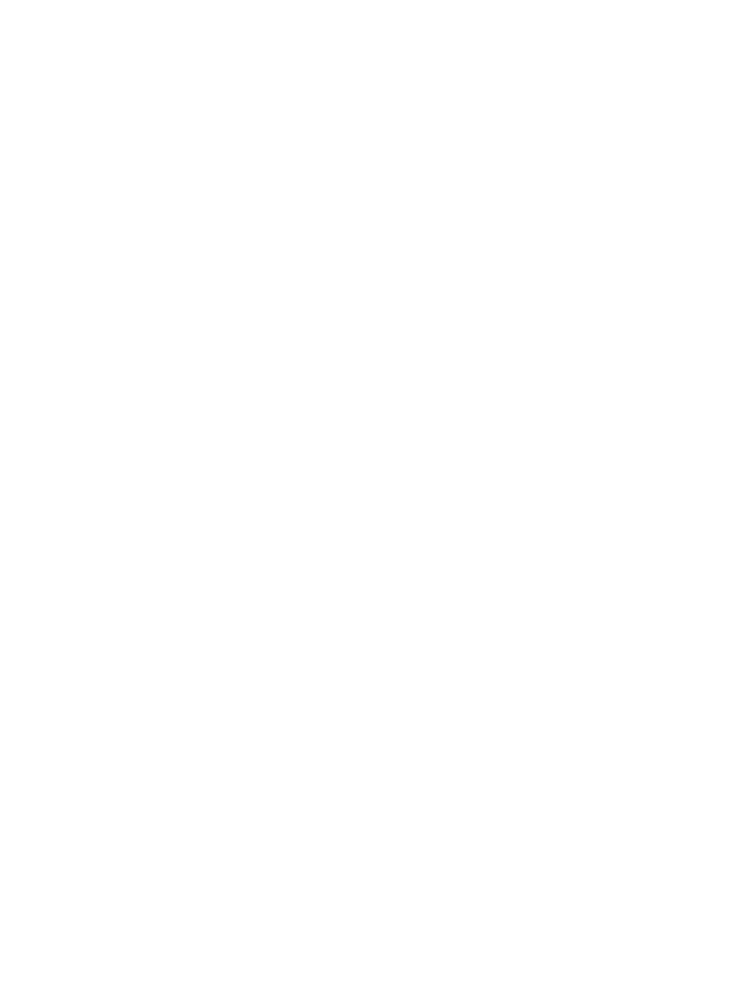

In [146]:
import folium
import matplotlib.pyplot as plt
from IPython.display import display, HTML

maps = []

for index, row in stations_df.iterrows():
    m = folium.Map(location=[row['X'], row['Y']], zoom_start=30)
    folium.Marker([row["X"], row["Y"]], popup=row["District Name"]).add_to(m)
    
    BURGLARY_data = police_2018[police_2018['Category'] == 'BURGLARY']
    BURGLARY_data['Date'] = pd.to_datetime(BURGLARY_data['Date'], format='%m/%d/%Y')

    BURGLARY_data['X'] = BURGLARY_data['X'].astype(float)
    BURGLARY_data['Y'] = BURGLARY_data['Y'].astype(float)
    BURGLARY_data = BURGLARY_data[['X', 'Y']]
    BURGLARY_data = BURGLARY_data.dropna(axis=0, subset=['X','Y'])
    BURGLARY_list = [[row['Y'],row['X']] for index, row in BURGLARY_data.iterrows()]
    HeatMap(BURGLARY_list, radius=25, blur = 15).add_to(m)
    maps.append(m._repr_html_())  

num_maps = len(maps)
num_cols = 3 
num_rows = (num_maps + num_cols - 1) // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, num_rows * 5))

for i, map_html in enumerate(maps):
    ax = axes[i // num_cols, i % num_cols]  
    ax.axis('off')
    display(HTML(map_html)) 

for i in range(num_maps, num_rows * num_cols):
    axes[i // num_cols, i % num_cols].axis('off')

plt.tight_layout()
plt.show()
